# Maladies chroniques : offre de soins, inégalités sociales ou facteurs environnementaux ?

# Installations

In [1]:
!pip install geopandas
!pip install contextily
!pip install xlrd
!pip install openpyxl
!pip install patool
!pip install rarfile

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.9/20.9 MB 14.7 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.8/119.8 kB 20.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.3/40.3 kB 17.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.5/96.5 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.1/242.1 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.5/77.5 kB 4.2 MB/s eta 0:00:00


# Packages

In [2]:
import requests
import pandas as pd
import io

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly
import plotly.express as px
from IPython.display import HTML

import geopandas as gpd
import contextily as ctx

import urllib

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [3]:
dico_grpes_sociopro = {
    '1' : 'Agriculteurs exploitants',
    '2' : 'Artisans, commerçants, chefs d\'entreprise',
    '3' : 'Cadres et professions intellectuelles supérieures',
    '4' : 'Professions intermédiaires',
    '5' : 'Employés',
    '6' : 'Ouvriers',
    '7' : 'Retraités',
    '8' : 'Autres'
}

# Partie 1 : Analyse de la table DREES
## 1.1 : Importation des tables & Premières stat desc sur les maladies chroniques

In [4]:
url_drees = "https://data.drees.solidarites-sante.gouv.fr/explore/dataset/er_inegalites_maladies_chroniques/download/?format=csv&timezone=Europe/Berlin&lang=fr&use_labels_for_header=true&csv_separator=%3B"

urlData = requests.get(url_drees).content
df_drees = pd.read_csv(io.StringIO(urlData.decode('utf-8')), sep = ";")
df_drees.head(3)

,type,varTaux,varTauxLib,I_cat,cat,catLib,varPartition,valPartition,varGroupage,valGroupage,varPoids,poids1,poidsTot,txNonStand,txStandDir,txStandDirModBB,txStandDirModBH,txStandIndir,txStandIndirModBB,txStandIndirModBH
0,prevalence,TOP_CVAOMI_IND,Artériopathie oblitérante du membre inférieur,0,SUP_CV_CAT,Maladies cardioneurovasculaires,FISC_REG_S,76,FISC_NIVVIEM_E2015_S_moy_10,1,POIDS_FIDELI_S,13621.000499,1.374418e+06,0.009910,0.014240,0.013046,0.015435,0.014738,0.013555,0.015921
1,prevalence,TOP_CVCORON_CHR,Maladie coronaire chronique,0,SUP_CV_CAT,Maladies cardioneurovasculaires,FISC_REG_S,76,FISC_NIVVIEM_E2015_S_moy_10,1,POIDS_FIDELI_S,30886.502030,1.374418e+06,0.022472,0.031912,0.030194,0.033631,0.033026,0.031317,0.034736
2,prevalence,TOP_CVVALVE_IND,Maladie valvulaire,0,SUP_CV_CAT,Maladies cardioneurovasculaires,FISC_REG_S,76,FISC_NIVVIEM_E2015_S_moy_10,1,POIDS_FIDELI_S,6482.669891,1.374418e+06,0.004717,0.006956,0.006101,0.007810,0.007021,0.006193,0.007848


## Fonction annexe qui récupère un sous-domaine pour étude

In [11]:
def calcul_nv_taux_non_stand(df_grouped) :
    # Cette fonction calcule un taux non standardisée après groupby
    poids1 = df_grouped['poids1'].sum()
    poidsTot = df_grouped['poidsTot'].sum()
    return poids1/poidsTot

def selection_variable_barplot(liste_var_groupage, liste_var_partition, type_var_groupage = float, type_var_partition = float, groupby = 'valGroupage', type_donnees = 'incidence', liste_maladies = ['Cancers','Diabète','Insuffisance rénale chronique terminale','Maladies cardioneurovasculaires','Maladies du foie ou du pancréas','Maladies inflammatoires ou rares ou VIH ou SIDA','Maladies neurologiques ou dégénératives', 'Maladies psychiatriques', 'Maladies respiratoires chroniques', 'Traitements du risque vasculaire', 'Traitements psychotropes']) :
    # On commence par ne sélectionner que les variables qu'on souhaite
    sous_df = df_drees[df_drees['type'] == type_donnees].copy()
    sous_df = sous_df[(sous_df['varGroupage'].isin(liste_var_groupage))
                           &(sous_df['varPartition'].isin(liste_var_partition))
                           &(sous_df['catLib'].isin(liste_maladies))
                           ].copy()
    # On vérifie les types
    sous_df = sous_df.astype({'valPartition' : type_var_partition, 'valGroupage' : type_var_groupage},  errors='ignore')

    # On fait le groupby + l'opération voulue
    grouped_df = sous_df.groupby(groupby, as_index = False)
    nouveau_taux_non_stand = grouped_df.apply(calcul_nv_taux_non_stand)
    nouveau_taux_non_stand = nouveau_taux_non_stand.rename(columns =  {None : 'txNonStandV2'})

    grouped_df = grouped_df.mean()
    grouped_df = grouped_df.merge(nouveau_taux_non_stand, on = groupby)

    grouped_df = grouped_df.sort_values(by = groupby)
    
    return grouped_df

In [12]:
# Un exemple d'application de la fonction précédente

df_loc = selection_variable_barplot(liste_var_groupage = ['FISC_NIVVIEM_E2015_S_moy_10'],
                                    liste_var_partition = ['FISC_REG_S'],
                                    type_var_groupage = int,
                                    type_var_partition = float,
                                    groupby = 'valGroupage',
                                    type_donnees = 'prevalence',
                                    liste_maladies =  ['Diabète']
                                   )
df_loc

/tmp/ipykernel_165/1590248948.py:22: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grouped_df = grouped_df.mean()


,valGroupage,I_cat,valPartition,poids1,poidsTot,txNonStand,txStandDir,txStandDirModBB,txStandDirModBH,txStandIndir,txStandIndirModBB,txStandIndirModBH,txNonStandV2
0,1,1.0,41.352941,47184.719759,834884.812968,0.062652,0.080784,0.076622,0.084945,0.082800,0.078656,0.086944,0.056516
1,2,1.0,41.352941,50810.186854,782426.091354,0.070028,0.080894,0.076380,0.085407,0.080668,0.076214,0.085122,0.064939
2,3,1.0,41.352941,52369.438854,772151.800252,0.072077,0.075571,0.070995,0.080147,0.074936,0.070479,0.079393,0.067823
3,4,1.0,41.352941,48715.465750,771156.949447,0.069067,0.071882,0.067055,0.076708,0.071304,0.066543,0.076066,0.063172
4,5,1.0,41.352941,46003.912948,775672.088137,0.064710,0.065665,0.060938,0.070392,0.065769,0.061148,0.070391,0.059308
5,6,1.0,41.352941,42091.117434,777276.709471,0.059388,0.060069,0.055460,0.064678,0.060006,0.055423,0.064588,0.054152
6,7,1.0,41.352941,39398.482424,778762.958651,0.058040,0.058382,0.053700,0.063064,0.058472,0.053784,0.063160,0.050591
7,8,1.0,41.352941,38382.790094,776740.089931,0.057501,0.053048,0.048773,0.057324,0.053172,0.048960,0.057384,0.049415
8,9,1.0,41.352941,36825.640070,772661.117897,0.055512,0.046200,0.042339,0.050060,0.046390,0.042649,0.050131,0.047661
9,10,1.0,41.352941,32852.510675,764772.416908,0.052380,0.036884,0.033568,0.040200,0.037688,0.034498,0.040878,0.042957


## 1.2 : Premiers graphiques à partie de la table DREES

In [13]:
# initialisation graphiques
plotly.io.templates.default = 'ggplot2'
plt.style.use('ggplot')
color_palette_ggplot = ['#F8766D','#00BE67','#E68613','#C77CFF','#8494FF','#7CAE00','#00A9FF']
#'#ABA300','#00C19A'

### Le taux de prévalence moyen des maladies cardioneurovasculaires par dixième de niveau de vie

#### Version 1 : Avec notre calcul non standardisé

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



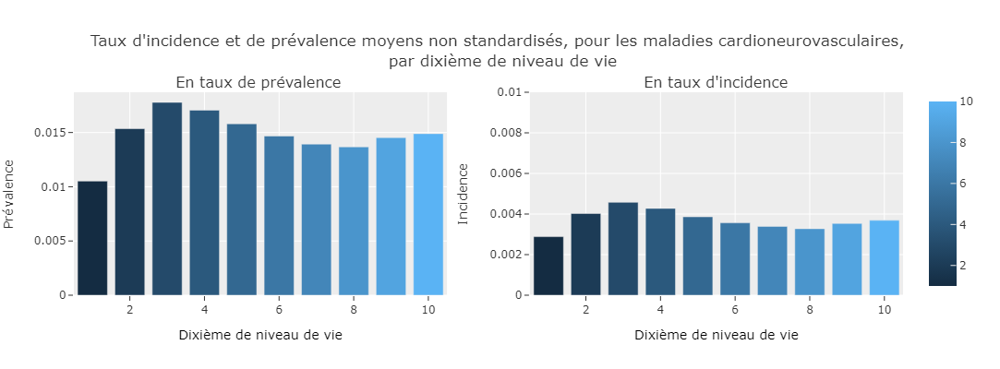

In [175]:
fig = make_subplots(rows=1, cols=2, subplot_titles=("\n En taux de prévalence \n\n", '\n En taux d\'incidence \n'))

#1er graphique
df_loc = selection_variable_barplot(liste_var_groupage = ['FISC_NIVVIEM_E2015_S_moy_10'],
                                    liste_var_partition = ['FISC_REG_S'],
                                    type_var_groupage = int,
                                    type_var_partition = float,
                                    groupby = 'valGroupage',
                                    type_donnees = 'prevalence',
                                    liste_maladies = ['Maladies cardioneurovasculaires']
                                   )
figure1 = px.bar(df_loc, orientation='v', x='valGroupage', y='txNonStandV2',color='valGroupage')
figure1_traces = []

for trace in range(len(figure1["data"])):
    figure1_traces.append(figure1["data"][trace])

fig.append_trace(figure1["data"][trace], row=1, col=1)
figure1.update_layout(showlegend=False)

#2ème graphique
df_loc = selection_variable_barplot(liste_var_groupage = ['FISC_NIVVIEM_E2015_S_moy_10'],
                                    liste_var_partition = ['FISC_REG_S'],
                                    type_var_groupage = int,
                                    type_var_partition = float,
                                    groupby = 'valGroupage',
                                    type_donnees = 'incidence',
                                    liste_maladies = ['Maladies cardioneurovasculaires']
                                   )

figure2 = px.bar(df_loc, orientation='v', x='valGroupage', y='txNonStandV2',color='valGroupage')
figure2_traces = []

for trace in range(len(figure1["data"])):
    figure2_traces.append(figure2["data"][trace])

fig.append_trace(figure2["data"][trace], row=1, col=2)
figure2.update_layout(showlegend=False)
  
# nom des axes
fig.update_xaxes(title_text="Dixième de niveau de vie", title_font=dict(color='black'), row=1, col=1)
fig.update_xaxes(title_text="Dixième de niveau de vie", title_font=dict(color='black'), row=1, col=2)
fig.update_yaxes(title_text="Prévalence", row=1, col=1)
fig.update_yaxes(title_text="Incidence", row=1, col=2, range=[0,0.01])

# titre et taille
fig.update_layout(showlegend=False,
                  title_text="\n Taux d\'incidence et de prévalence moyens non standardisés, pour les maladies cardioneurovasculaires, <br> par dixième de niveau de vie \n",
                  height=400,
                  autosize=True)
#fig.update_traces(marker_color='lightsalmon')

fig.show()

#### Version 2 : En faisant la moyenne des taux standardisés

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



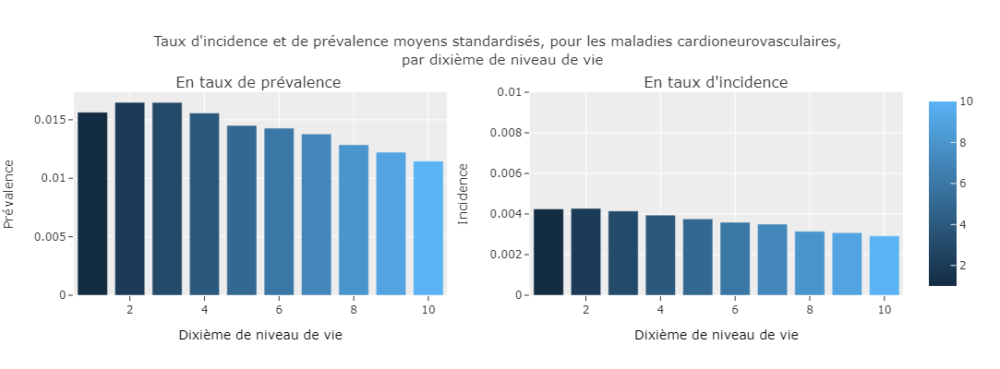

In [176]:
fig = make_subplots(rows=1, cols=2, subplot_titles=("\n En taux de prévalence \n\n", '\n En taux d\'incidence \n'))

#1er graphique

df_loc = selection_variable_barplot(liste_var_groupage = ['FISC_NIVVIEM_E2015_S_moy_10'],
                                    liste_var_partition = ['FISC_REG_S'],
                                    type_var_groupage = int,
                                    type_var_partition = float,
                                    groupby = 'valGroupage',
                                    type_donnees = 'prevalence',
                                    liste_maladies = ['Maladies cardioneurovasculaires']
                                   )

figure1 = px.bar(df_loc, orientation='v', x='valGroupage', y='txStandDir',color='valGroupage')
figure1_traces = []

for trace in range(len(figure1["data"])):
    figure1_traces.append(figure1["data"][trace])

fig.append_trace(figure1["data"][trace], row=1, col=1)
figure1.update_layout(showlegend=False)

#2ème graphique
df_loc = selection_variable_barplot(liste_var_groupage = ['FISC_NIVVIEM_E2015_S_moy_10'],
                                    liste_var_partition = ['FISC_REG_S'],
                                    type_var_groupage = int,
                                    type_var_partition = float,
                                    groupby = 'valGroupage',
                                    type_donnees = 'incidence',
                                    liste_maladies = ['Maladies cardioneurovasculaires']
                                   )

figure2 = px.bar(df_loc, orientation='v', x='valGroupage', y='txStandDir',color='valGroupage')
figure2_traces = []

for trace in range(len(figure1["data"])):
    figure2_traces.append(figure2["data"][trace])

fig.append_trace(figure2["data"][trace], row=1, col=2)
figure2.update_layout(showlegend=False)
                  
fig.update_xaxes(title_text="Dixième de niveau de vie", title_font=dict(color='black'), row=1, col=1)
fig.update_xaxes(title_text="Dixième de niveau de vie", title_font=dict(color='black'), row=1, col=2)
fig.update_yaxes(title_text="Prévalence", row=1, col=1)
fig.update_yaxes(title_text="Incidence", row=1, col=2, range=[0,0.01])

# titre et taille
fig.update_layout(showlegend=False,
                  height=400,
                  autosize=True,
                  title_text = 'Taux d\'incidence et de prévalence moyens standardisés, pour les maladies cardioneurovasculaires, <br> par dixième de niveau de vie',
                  title_font_size = 15)

fig.show()



On remarque que les résultats sont légèrement différents. Compte tenu des données à notre disposition, on se contentera d'utiliser les taux non standardisés par la suite.

### Le taux d'incidence moyen par groupe socioprofessionnel, toujours pour les maladies cardioneurovasculaires

In [16]:
df_loc = selection_variable_barplot(liste_var_groupage = ['EAR_GS_S'],
                                    liste_var_partition = ['SEXE'],
                                    type_var_groupage = str,
                                    type_var_partition = float,
                                    groupby = 'valGroupage',
                                    liste_maladies = ['Maladies cardioneurovasculaires']
                                   )
df_loc.replace({'valGroupage' : dico_grpes_sociopro}, inplace=True)


fig = px.bar(df_loc.sort_values('txNonStandV2', ascending=True),
             orientation='h',
             x='txNonStandV2', y='valGroupage', color = 'valGroupage', 
             color_discrete_sequence=color_palette_ggplot)

fig.update_layout(
     title='\n Taux d\'incidence non standardisé par groupe socioprofessionnel \n',
     xaxis_title='Incidence',
     yaxis_title='Groupe socioprofessionnel',
     title_x=0.5,
     autosize=True,
     showlegend=False)
fig.update_xaxes(title_font=dict(color='black'))

HTML(fig.to_html())

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



### Comparaison des taux d'incidence moyens non standardisés par maladie et par groupe socioprofessionnel

In [150]:
df_loc = selection_variable_barplot(liste_var_groupage = ['EAR_GS_S'],
                                    liste_var_partition = ['SEXE'],
                                    type_var_groupage = str,
                                    type_var_partition = float,
                                    groupby = ['valGroupage', 'catLib']
                                   )
df_loc.replace({'valGroupage' : dico_grpes_sociopro}, inplace=True)

fig = px.bar(df_loc, x='catLib',
             y='txNonStandV2', 
             color = 'valGroupage', 
             barmode='group', 
             color_discrete_sequence=color_palette_ggplot)

fig.update_layout(
     title='\n Taux d\'incidence non standardisé par catégorie de maladie et groupe socioprofessionnel  \n',
     xaxis_title='Catégorie de maladie',
     yaxis_title='Incidence',
     title_x=0.5, 
     height=700,
     legend_title_text= 'Groupe socioprofessionnel',
     autosize=True)

HTML(fig.to_html())

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



Remarque : le HTML est un format interactif, l'utilisateur est libre de zoomer / sélectionner des variables, ...

### Comparaison des taux d'incidence moyens standardisés par maladie et par décile de niveau de vie

In [171]:
df_loc = selection_variable_barplot(liste_var_groupage = ['FISC_NIVVIEM_E2015_S_moy_10'],
                                    liste_var_partition = ['SEXE'],
                                    type_var_groupage = str,
                                    type_var_partition = float,
                                    groupby = ['valGroupage', 'catLib']
                                   )
df_loc = df_loc.astype({'valGroupage':'int'})
df_loc = df_loc.sort_values('valGroupage',ascending=True)
df_loc = df_loc.astype({'valGroupage':'str'})


fig = px.bar(df_loc, x='catLib',
             y='txStandDir', 
             color = 'valGroupage', 
             barmode='group', 
             color_discrete_sequence=color_palette_ggplot)

fig.update_layout(
     title='\n Taux d\'incidence standardisé direct par catégorie de maladie et décile de niveau de vie  \n',
     xaxis_title='Catégorie de maladie',
     yaxis_title='Incidence',
     title_x=0.5, 
     height=700,
     legend_title_text= 'Dixième de niveau de vie',
     autosize=True)

HTML(fig.to_html())

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



### Comparaison des taux d'incidence non standardisés moyen par maladie et par sexe

In [18]:
df_loc = selection_variable_barplot(liste_var_groupage = ['SEXE'],
                                    liste_var_partition = ['FISC_REG_S'],
                                    type_var_groupage = float,
                                    type_var_partition = int,
                                    groupby = ['catLib','valGroupage']
                                   )


fig = px.bar(df_loc,
             x='catLib',
             y='txNonStandV2',
             color = 'valGroupage',
             barmode='group',
             color_discrete_sequence=color_palette_ggplot,
             width=700, height=700)

fig.update_layout(
     title='\n Taux d\'incidence non standardisé par maladie et par sexe  \n',
     xaxis_title='Catégorie de maladie',
     yaxis_title='Incidence',
     legend_title_text = 'Sexe',
     title_x=0.5,
     autosize=True)

HTML(fig.to_html())

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



### A quelles variables sont corrélés les taux de prévalence ?

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will defaul

(array([0.5, 1.5, 2.5, 3.5]),
 [Text(0.5, 0, 'niveau de vie'),
  Text(1.5, 0, 'Indice socioprofessionnel'),
  Text(2.5, 0, "classe d'âge"),
  Text(3.5, 0, 'niveau de diplômes')])

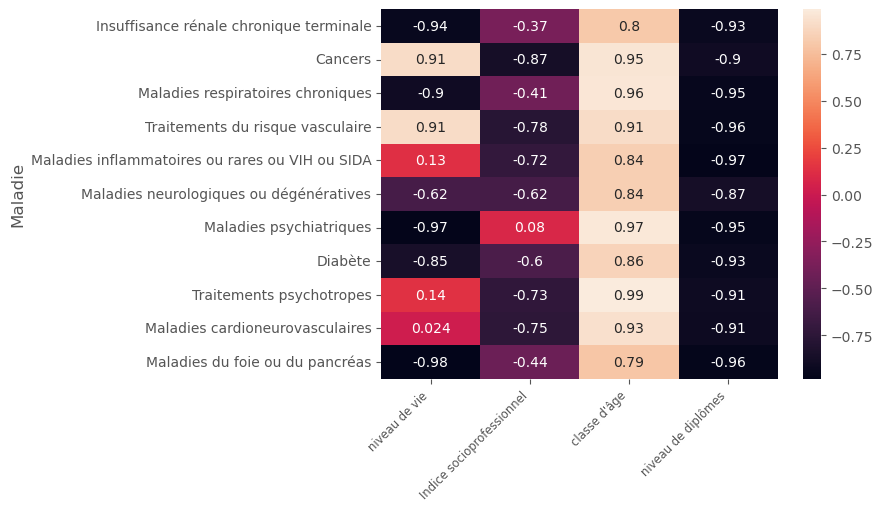

In [19]:
def calcul_correlation_maladies(var_groupage, variable_indic = 'txNonStandV2', type_donnees = 'prevalence') :
    # Cette fonction renvoie un df :
        # index = maladie
        # colonne = corrélation avec la variable var_groupage du taux
    
    #On récupère le sous_df
    df_loc = selection_variable_barplot(liste_var_groupage = [var_groupage],
                                    liste_var_partition = ['SEXE'],
                                    type_var_groupage = int,
                                    type_var_partition = float,
                                    groupby = ['valGroupage', 'catLib'],
                                    type_donnees = type_donnees
                                   )

    #On modifie la variable des maladies pour pouvoir parcourir
    df_loc = df_loc.astype({'catLib' : 'category'})
    
    if var_groupage == 'classeAge10' :
        #Comme l'âge n'est pas mis sous forme d'entier il faut un petit traitement...
        df_loc['valGroupage'] = 10* df_loc['valGroupage'].apply(lambda x : 2 if x == '<30'
                                else 9 if x == '>=90'
                                else x[0]).astype('int')

    # On calcule les corrélations
    liste_corr = []
    liste_maladies = list(set(df_loc['catLib']))
    for maladie in liste_maladies :
        sous_df = df_loc[df_loc['catLib'] == maladie]
        corr = sous_df[variable_indic].corr(sous_df['valGroupage'])
        liste_corr.append(corr)

    # On met sous forme de DF
    dic = {}
    dic['Maladie'] = liste_maladies
    dic['Corrélation_'+str(var_groupage)] = liste_corr
    return pd.DataFrame(data = dic)

def calcul_toutes_correlations_maladies(liste_var_groupage, variable_indic = 'txStandDir', type_donnees = 'prevalence') :
    # On initialise
    df_correlations = calcul_correlation_maladies(liste_var_groupage[0], variable_indic = variable_indic,  type_donnees = type_donnees)

    # Puis on parcours toutes les maladies
    for var_groupage in liste_var_groupage[1:] :
        sous_df = calcul_correlation_maladies(var_groupage, variable_indic = variable_indic,  type_donnees = type_donnees)
        df_correlations = df_correlations.merge(sous_df, left_on = 'Maladie', right_on = 'Maladie')
    return df_correlations

liste_var_groupage = ['FISC_NIVVIEM_E2015_S_moy_10', 'EAR_GS_S', 'classeAge10', 'EAR_DIPLR_S']

df_recap_correlations = calcul_toutes_correlations_maladies(liste_var_groupage, variable_indic = 'txNonStandV2', type_donnees = 'prevalence')
df_recap_correlations = df_recap_correlations.set_index('Maladie')
df_recap_correlations = df_recap_correlations.rename(columns = {'Corrélation_FISC_NIVVIEM_E2015_S_moy_10' : 'niveau de vie',
                                                               'Corrélation_EAR_DIPLR_S' : 'niveau de diplômes',
                                                               'Corrélation_classeAge10' : 'classe d\'âge',
                                                               'Corrélation_EAR_GS_S' : 'Indice socioprofessionnel'})

sns.heatmap(df_recap_correlations, annot=True)
plt.xticks(rotation=45, horizontalalignment='right', fontweight='light', fontsize='small')


Premières remarques : La classe d'âge et le niveau de diplômes ont environ la même corrélation pour toutes les maladies chroniques. Mais par contre, le niveau de vie est corrélé de manière différentes en fonction des maladies.

## Partie 2 : Constitution d'une table d'analyse médicale, géographique et socio-économique par région

Dans cette partie, on va récupérer diverses données par région pour pouvoir continuer notre analyse.

## 2.1 Constitution de la base

### La géographie

In [20]:
# Pour télécharger le fond de carte : https://github.com/gregoiredavid/france-geojson/blob/master/regions-version-simplifiee.geojson'
# A voir si on peut le push sur git, et si on ne peut pas le télécharger automatiquement à chaque fois...

sf = gpd.read_file('regions-version-simplifiee.geojson')
sf.head(3)

ERROR 1: PROJ: proj_create_from_database: Open of /opt/mamba/share/proj failed


,code,nom,geometry
0,11,Île-de-France,"POLYGON ((2.59052 49.07965, 2.63327 49.10838, ..."
1,24,Centre-Val de Loire,"POLYGON ((2.87463 47.52042, 2.88845 47.50943, ..."
2,27,Bourgogne-Franche-Comté,"POLYGON ((3.62942 46.74946, 3.57569 46.74952, ..."


Tout d'abord la carte de France et des régions :


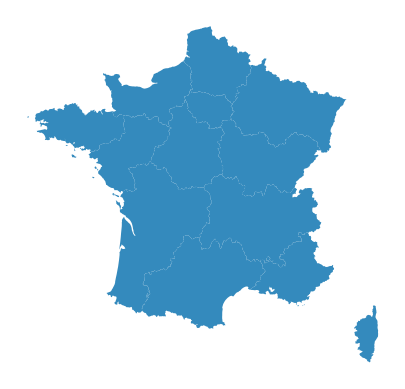

In [21]:
ax = sf.plot()
ax.set_axis_off()
print("Tout d'abord la carte de France et des régions :")

## Le nombre de médecins 

In [22]:
# Un peu plus compliqué parce que le fichier compte deux sheet : un pour les deps et un pour les régions...
url_nb_medecins = "https://www.insee.fr/fr/statistiques/fichier/2012677/TCRD_068.xls"
outfilename = "nb_medecins.xls"
urllib.request.urlretrieve(url_nb_medecins, outfilename) 
df_nb_medecins = pd.read_excel('nb_medecins.xls','REG', header = 4)
df_nb_medecins = df_nb_medecins.rename(columns = {'Unnamed: 0' : 'Index_region','Unnamed: 1' : 'Nom_region'})
df_nb_medecins.head(4)

,Index_region,Nom_region,Ensemble des médecins,Ensemble des médecins.1,dont général.,dont spécial.,Chirurg. dentistes,Infirmiers diplômés d’État,Pharm.
0,84,Auvergne-Rhône-Alpes,27117.0,340.0,157.0,183.0,64.0,1118.0,117.0
1,27,Bourgogne-Franche-Comté,8373.0,297.0,144.0,153.0,50.0,1065.0,110.0
2,53,Bretagne,10654.0,321.0,159.0,161.0,62.0,1106.0,101.0
3,24,Centre-Val de Loire,6844.0,265.0,124.0,141.0,44.0,882.0,106.0


## Les surfaces agricoles

In [23]:
url_agricole = "https://www.insee.fr/fr/statistiques/fichier/5039859/FET2021-7.xlsx"
nom_fiche = "Figure 1"

outfilename = "agricole1.xls"
urllib.request.urlretrieve(url_agricole, outfilename) 

df_agricole1 = pd.read_excel('agricole1.xls',nom_fiche, header = 4)
df_agricole1 = df_agricole1.rename(columns = {'Unnamed: 0' : 'Nom_region',
                                            '(en %)' : 'Part_SAU',
                                           '(en milliards d\'euros)' : 'Prod_agr_moyenne',
                                           'Unnamed: 3' : 'Prod_agr_2018',
                                           '(en %).1' : 'Part_vegetale',
                                           'Unnamed: 5' : 'Part_animale'})
df_agricole1 = df_agricole1.astype({'Nom_region' : str})



nom_fiche = "Figure 2"

outfilename = "agricole2.xls"
urllib.request.urlretrieve(url_agricole, outfilename) 

df_agricole2 = pd.read_excel('agricole2.xls',nom_fiche, header = 2)
df_agricole2 = df_agricole2.rename(columns = {'Unnamed: 0' : 'Nom_region', 'Autres1' : 'Autres'})[['Nom_region', 'Grandes cultures', 'Cultures permanentes', 'Cultures fourragères', 'Autres']]
df_agricole2 = df_agricole2.astype({'Nom_region' : str})
df_agricole2['Nom_region'] = df_agricole2['Nom_region'].apply(lambda x : x[1:])


df_agricole = df_agricole1.merge(df_agricole2, on = 'Nom_region', how = 'inner', left_index=False, right_index=False)
df_agricole.head(3)

,Nom_region,Part_SAU,Prod_agr_moyenne,Prod_agr_2018,Part_vegetale,Part_animale,Grandes cultures,Cultures permanentes,Cultures fourragères,Autres
0,Auvergne-Rhône-Alpes,44.0,5.80,6.10,43.0,50.0,22.0,3.0,74.0,1.0
1,Bourgogne-Franche-Comté,53.0,4.94,5.72,64.0,33.0,42.0,2.0,56.0,0.0
2,Bretagne,62.0,8.34,8.66,26.0,65.0,42.0,0.0,56.0,2.0


## Les données socio-économiques

In [24]:
import urllib
import rarfile
from io import BytesIO, StringIO
import requests, zipfile


url = "https://www.insee.fr/fr/statistiques/fichier/6036902/base-cc-filosofi-2019_XLSX.zip"

r = requests.get(url)
z = zipfile.ZipFile(io.BytesIO(r.content))
z.extractall()

nom_fiche = "REG"

df_soc_eco = pd.read_excel('base-cc-filosofi-2019-geo2022.xlsx',nom_fiche, header = 4)
df_soc_eco.head(3)


,Code géographique,Libellé géographique,Nombre de ménages fiscaux,Nombre de personnes dans les ménages fiscaux,Médiane du niveau vie (€),Part des ménages fiscaux imposés (%),Taux de pauvreté-Ensemble (%),Taux de pauvreté-moins de 30 ans (%),Taux de pauvreté-30 à 39 ans (%),Taux de pauvreté-40 à 49 ans (%),...,"Part des pensions, retraites et rentes (%)",Part des revenus du patrimoine et autres revenus (%),Part de l'ensemble des prestations sociales (%),dont part des prestations familiales (%),dont part des minima sociaux (%),dont part des prestations logement (%),Part des impôts (%),1er décile du niveau de vie (€),9e décile du niveau de vie (€),Rapport interdécile 9e décile/1er décile
0,CODGEO,LIBGEO,NBMENFISC19,NBPERSMENFISC19,MED19,PIMP19,TP6019,TP60AGE119,TP60AGE219,TP60AGE319,...,PPEN19,PPAT19,PPSOC19,PPFAM19,PPMINI19,PPLOGT19,PIMPOT19,D119,D919,RD19
1,02,Martinique,149292,324217,18570,39.2,27.4,45.4,33.4,28.8,...,24.7,5.6,12.2,2.6,7.6,2,-13.7,9090,37360,4.1
2,04,La Réunion,322669,867558,15890,33.3,37.2,53,41.2,37.7,...,15.7,6.5,17.3,4.4,9.6,3.3,-13.1,8400,36210,4.3


### La densité de population par région

In [25]:
url = "https://www.insee.fr/fr/statistiques/fichier/4277596/T20F013.xlsx"

outfilename = "densite_region.xls"
urllib.request.urlretrieve(url, outfilename) 
df_densite = pd.read_excel('densite_region.xls','Figure 1', header = 3)
df_densite = df_densite.rename(columns = {'Unnamed: 0' : 'Nom_region', "Unnamed: 1" : 'pop_region_2020', 'Totale' : 'Variation_totale', "Due au solde naturel" : "Variation_solde_nat", "Due au solde\napparent\ndes entrées\net des\nsorties2" : "Variation_E_S", "Unnamed: 5" : "Densite_moyenne"})
df_densite.head(4)


,Nom_region,pop_region_2020,Variation_totale,Variation_solde_nat,Variation_E_S,Densite_moyenne
0,Auvergne-Rhône-Alpes,8032.377,0.5,0.3,0.2,115.223788
1,Bourgogne-Franche-Comté,2783.039,-0.2,0,-0.2,58.241703
2,Bretagne,3340.379,0.4,0,0.4,122.772393
3,Centre-Val de Loire,2559.073,0,0.1,-0.1,65.364347


## Constitution de la table

In [26]:
df_region = sf.merge(df_nb_medecins, how = "inner", left_on = "nom", right_on = "Nom_region")
df_region = df_region.merge(df_agricole, how = "inner", left_on = "Nom_region", right_on = "Nom_region")
df_region = df_region.merge(df_soc_eco, how = "inner", left_on = "Nom_region", right_on = "Libellé géographique")
df_region = df_region.merge(df_densite, how = "inner", left_on = "Nom_region", right_on = "Nom_region")
df_region.head(3)

,code,nom,geometry,Index_region,Nom_region,Ensemble des médecins,Ensemble des médecins.1,dont général.,dont spécial.,Chirurg. dentistes,...,dont part des prestations logement (%),Part des impôts (%),1er décile du niveau de vie (€),9e décile du niveau de vie (€),Rapport interdécile 9e décile/1er décile,pop_region_2020,Variation_totale,Variation_solde_nat,Variation_E_S,Densite_moyenne
0,11,Île-de-France,"POLYGON ((2.59052 49.07965, 2.63327 49.10838, ...",11,Île-de-France,48236.0,396.0,145.0,251.0,73.0,...,1,-22.9,11110,49090,4.4,12278.210,0.4,0.9,-0.5,1022.136477
1,24,Centre-Val de Loire,"POLYGON ((2.87463 47.52042, 2.88845 47.50943, ...",24,Centre-Val de Loire,6844.0,265.0,124.0,141.0,44.0,...,1.2,-15.8,12130,36070,3,2559.073,0,0.1,-0.1,65.364347
2,27,Bourgogne-Franche-Comté,"POLYGON ((3.62942 46.74946, 3.57569 46.74952, ...",27,Bourgogne-Franche-Comté,8373.0,297.0,144.0,153.0,50.0,...,1.2,-15.9,12230,36830,3,2783.039,-0.2,0,-0.2,58.241703


## 2.2 Analyse de la table par région

### Nombre de médecins par région en fonction du niveau de vie

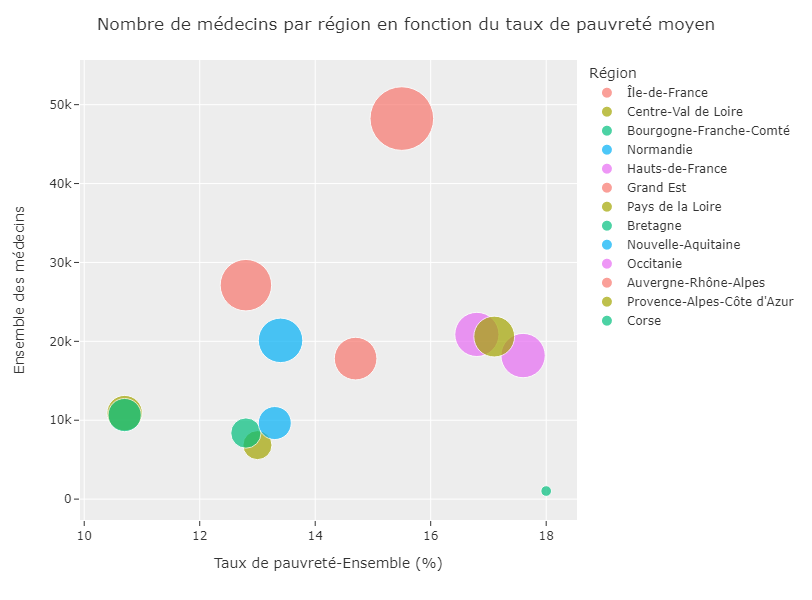

In [28]:
fig = px.scatter(df_region,
                 x="Taux de pauvreté-Ensemble (%)",
                 y='Ensemble des médecins',
                 color='nom',
                 size='pop_region_2020',
                 size_max=45)

fig.update_layout(showlegend=True, 
                  legend_title ='Région', 
                  title_text="\n Nombre de médecins par région en fonction du taux de pauvreté moyen\n", 
                  height=600,
                  autosize=True)

fig.show()

### Nombre de médecins par région

/tmp/ipykernel_165/1346103095.py:3: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




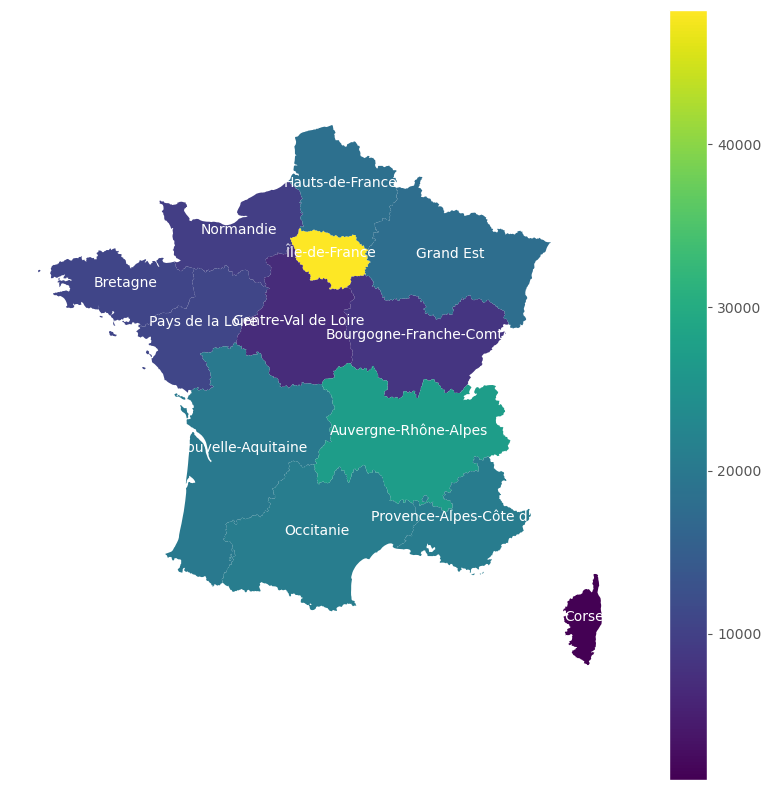

In [177]:
#### EN AJOUTANT LES NOMS DE REGIONS

df_region["centre_regions"] = df_region.centroid


fig,ax = plt.subplots(figsize=(10, 10))
df_region.plot(ax = ax, column = "Ensemble des médecins", legend=True)

for num_ligne in range(len(df_region)) :
    ligne = df_region.iloc[num_ligne]
    x = ligne['centre_regions'].x
    y = ligne['centre_regions'].y
    ax.annotate(ligne["nom"], xy = (x, y), xytext = (0, 0), textcoords="offset points", ha='center', color='white')

ax.set_axis_off()
ax
plt.show()

# for x, y, label in zip(cities.geometry.x, cities.geometry.y, cities.name):
#     ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points")

#### On tente de faire une carte html

In [31]:
import json
df_region_loc = df_region[['nom','geometry','pop_region_2020','Densite_moyenne','Ensemble des médecins']]
df_region_loc.dtypes
df_region_loc_json = json.loads(df_region_loc.to_json())
#Convert to String like object.
json_data = json.dumps(df_region_loc_json)

In [32]:
from bokeh.io import output_notebook, show, output_file, curdoc
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar, Slider, HoverTool
from bokeh.palettes import brewer
from bokeh.layouts import row, column

#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data)

hover = HoverTool(tooltips = [ ('region','@nom'),('% population', '@pop_region_2020')])
color_mapper = LinearColorMapper(palette = brewer['YlGnBu'][8], low = 0, high = 40)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
border_line_color=None,location = (0,0), orientation = 'horizontal')

p = figure(title = 'abc', toolbar_location = None)
p.patches('xs','ys', source = geosource,fill_color = {'field' :'pop_region_2020', 'transform' : color_mapper},
          line_color = 'black', line_width = 0.25, fill_alpha = 1)
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None
p.add_layout(color_bar, 'below')
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

(non concluant encore)

# Partie 3 : Un peu de modélisation

## 3.1 : Préparation de la base, puis des sous-fonctions utilisées

### On concatène toutes les maladies

Avec cette première base jointe, on concatène, par région, les données liées à toutes les maladies avec la base construite dans la partie 2.

In [36]:
df_concat = pd.DataFrame(data = None)
liste_maladies = list(set(df_drees['catLib']))

for maladie in liste_maladies :
    df_loc = selection_variable_barplot(
                            liste_var_groupage = ['FISC_NIVVIEM_E2015_S_moy_10'],
                            liste_var_partition = ['FISC_REG_S'],
                            type_var_groupage = int,
                            type_var_partition = object,
                            groupby = 'valPartition',
                            type_donnees = 'incidence',
                            liste_maladies = [maladie]
                            )
    
    df_loc['catLib'] = maladie
    
    df_merged_par_region = df_region.copy().merge(df_loc, left_on = 'code', right_on = 'valPartition', left_index=False, right_index=False, how = 'left')
    
    df_concat = pd.concat([df_concat, df_merged_par_region])

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will defaul

In [178]:
df_concat.head(5)

,code,nom,geometry,Index_region,Nom_region,Ensemble des médecins,Ensemble des médecins.1,dont général.,dont spécial.,Chirurg. dentistes,...,poidsTot,txNonStand,txStandDir,txStandDirModBB,txStandDirModBH,txStandIndir,txStandIndirModBB,txStandIndirModBH,txNonStandV2,catLib
0,11,Île-de-France,"POLYGON ((2.59052 49.07965, 2.63327 49.10838, ...",11,Île-de-France,48236.0,396.0,145.0,251.0,73.0,...,2.258614e+06,0.000118,0.000127,0.000053,0.000201,0.000129,0.000055,0.000202,0.000112,Insuffisance rénale chronique terminale
1,24,Centre-Val de Loire,"POLYGON ((2.87463 47.52042, 2.88845 47.50943, ...",24,Centre-Val de Loire,6844.0,265.0,124.0,141.0,44.0,...,4.905825e+05,0.000131,0.000136,-0.000011,0.000282,0.000138,-0.000010,0.000286,0.000127,Insuffisance rénale chronique terminale
2,27,Bourgogne-Franche-Comté,"POLYGON ((3.62942 46.74946, 3.57569 46.74952, ...",27,Bourgogne-Franche-Comté,8373.0,297.0,144.0,153.0,50.0,...,5.373854e+05,0.000109,0.000111,-0.000007,0.000230,0.000112,-0.000005,0.000228,0.000114,Insuffisance rénale chronique terminale
3,28,Normandie,"POLYGON ((-1.11962 49.35557, -1.07822 49.38849...",28,Normandie,9642.0,288.0,141.0,148.0,41.0,...,6.355859e+05,0.000084,0.000094,-0.000005,0.000193,0.000091,-0.000004,0.000186,0.000088,Insuffisance rénale chronique terminale
4,32,Hauts-de-France,"POLYGON ((4.04797 49.40564, 4.03991 49.39740, ...",32,Hauts-de-France,18196.0,302.0,147.0,155.0,48.0,...,1.138221e+06,0.000110,0.000118,0.000028,0.000208,0.000116,0.000029,0.000204,0.000116,Insuffisance rénale chronique terminale


In [38]:
fig = px.box(df_concat,
             x='nom',
             y='txStandDir',
             color_discrete_sequence=color_palette_ggplot,
             notched=False)

fig.update_layout(
     title='\n Taux d\'incidence par région \n',
     xaxis_title='Région',
     yaxis_title='Incidence',
     autosize=True)


HTML(fig.to_html())


On a maintenant accès au taux d'incidence par région, mais pour toutes les maladies d'un coup.

## On réorganise un petit peu

In [39]:
df_loc = selection_variable_barplot(
                        liste_var_groupage = ['FISC_NIVVIEM_E2015_S_moy_10'],
                        liste_var_partition = ['FISC_REG_S'],
                        type_var_groupage = int,
                        type_var_partition = object,
                        groupby = 'valPartition',
                        type_donnees = 'incidence'
                        )
df_concat_wide = df_region.copy().merge(df_loc, left_on = 'code', right_on = 'valPartition', left_index=False, right_index=False, how = 'left')

df_concat_wide = df_concat_wide.drop(columns = ['poidsTot', 'txNonStand','txStandDir','txStandDirModBB','txStandDirModBH','txStandIndir','txStandIndirModBB','txStandIndirModBH', 'valPartition', 'I_cat', 'valGroupage', 'poids1'])


for maladie in set(df_concat['catLib']) :
    sous_df = df_concat[df_concat['catLib'] == maladie]
    serie_taux_non_stand = sous_df['txNonStandV2']
    df_concat_wide['txNonStandV2_' + str(maladie)] = serie_taux_non_stand

/tmp/ipykernel_165/1590248948.py:22: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



### Les fonctions qu'on va utiliser

In [185]:
def trace_cercle_individus3(liste_variables_x, df_loc, liste_variables_supp = [], afficher_var=True, afficher_var_supp=True) :
    
    # On ne prend que les colonnes qui nous intéressent
    X = df_loc[liste_variables_x]
    liste_regions = X.index
    
    # On standardise
    scaler = StandardScaler()
    X = scaler.fit_transform(X)
    X = pd.DataFrame(data = X, columns = liste_variables_x)

    # On fait la PCA
    pca = PCA(n_components=2) 
    X_new = pca.fit_transform(X)
    
    fig = go.Figure()
    
    # On s'occupe des variables supplémentaires
    if len(liste_variables_supp) > 0 :
        X_supp = df_loc[liste_variables_supp]
        scaler_supp = StandardScaler()
        X_supp = scaler_supp.fit_transform(X_supp)
        X_supp = pd.DataFrame(data = X_supp, columns = liste_variables_supp)
        X_new = pd.DataFrame(data = X_new, columns = ['PCA_1', 'PCA_2'])
        X_supp_new = X_new.merge(X_supp, left_index=True, right_index=True)

            
        for label in liste_variables_supp :
            coord_x = [0,X_supp_new[label].corr(X_supp_new['PCA_1'])]
            coord_y = [0,X_supp_new[label].corr(X_supp_new['PCA_2'])]

            # on trace les lignes
            fig.add_trace(go.Scatter(x=coord_x,y=coord_y,
                                      text=['',label],
                                      textposition='bottom center',
                                      mode='lines+text',
                                      name='Variable supplémentaire',
                                      marker=dict(symbol='line-ne'),
                                      line=dict(color='#00BE67',width=1)))

            if afficher_var_supp==False :
                fig.update_traces(mode='lines')

            # ajout des flèches
            fig.add_annotation(
                    x= X_supp_new[label].corr(X_supp_new['PCA_1']),
                    y= X_supp_new[label].corr(X_supp_new['PCA_2']),
                    xref="x", yref="y",
                    text="",
                    showarrow=True,
                    axref = "x", ayref='y',
                    ax= 0,
                    ay= 0,
                    arrowhead = 2,
                    arrowsize=2,
                    arrowwidth=1,
                    arrowcolor='#00BE67')


    # Les variables principales
    
    
   
    # On s'occupe des variables principales
    X_new = pd.DataFrame(data = X_new, columns = ['PCA_1', 'PCA_2'])
    X_new = X_new.merge(X, left_index=True, right_index=True)
    
   
    for label in liste_variables_x :
        coord_x = [0,X_new[label].corr(X_new['PCA_1'])]
        coord_y = [0,X_new[label].corr(X_new['PCA_2'])]
        
        # on trace les lignes
        fig.add_trace(go.Scatter(x=coord_x,y=coord_y,
                                  text=['',label],
                                  textposition='top right',
                                  mode='lines+text',
                                  name='Variable principale',
                                  marker=dict(symbol='line-ne'),
                                  line=dict(color='#8494FF',width=1)))
        if afficher_var==False :
            fig.update_traces(mode='lines')
        
        # ajout des flèches
        fig.add_annotation(
                x= X_new[label].corr(X_new['PCA_1']),
                y= X_new[label].corr(X_new['PCA_2']),
                xref="x", yref="y",
                text="",
                showarrow=True,
                axref = "x", ayref='y',
                ax= 0,
                ay= 0,
                arrowhead = 2,
                arrowsize=2,
                arrowwidth=1,
                arrowcolor='#8494FF')
        # '#F8766D'(rose),'#00BE67'(vert),'#E68613'(orange),'#C77CFF'(violet),'#8494FF'(bleu),'#7CAE00','#00A9FF'(bleu)#'#ABA300'(vert),'#00C19A'(vert kaki)
    
    # Esthétique
    x, y = 0,1
    fig.update_layout(
         title=('Cercle des corrélations (F{} et F{})'.format(x+1, y+1)),
         xaxis_title=('F{} ({}%)'.format(x+1, round(100*pca.explained_variance_ratio_[x],1))),
         yaxis_title='F{} ({}%)'.format(y+1, round(100*pca.explained_variance_ratio_[y],1)), 
         height=710,
         width=950,
         autosize=True,
         showlegend=False,
         uniformtext_minsize=3, uniformtext_mode='hide'
    )
    
    fig.update_xaxes(range=[-1.5,2])
    fig.update_yaxes(range=[-1.1,1.2],automargin=True)
    
    fig.add_shape(type="line",
                  x0=0, y0=-1,
                  x1=0, y1=1,
                  line=dict(color='grey', width=1.5)
                 )
    fig.add_shape(type="line",
                  x0=-1, y0=0,
                  x1=1, y1=0,
                  line=dict(color='grey', width=1.5)
                 )
    

    # Ajout légende
    fig.add_annotation(
        x=-1.5,
        y=1.12,
        xref="x",
        yref="y",
        text='Variables principales',
        align="center",
        font=dict(color='black'),
        bordercolor='#8494FF',
        bgcolor='#8494FF',
        borderwidth=2,
        borderpad=4,
        xanchor='left',
        opacity=0.6,
        showarrow=False
        )
    
    if len(liste_variables_supp) > 0 :
        fig.add_annotation(
            x=-1.5,
            y=1,
            xref="x",
            yref="y",
            text='Variables supplémentaires',
            align="left",
            font=dict(color='black'),
            bordercolor='#00BE67',
            bgcolor='#00BE67',
            borderwidth=2,
            borderpad=4,
            xanchor='left',
            opacity=0.6,
            showarrow=False
            )
    
    # Ajout du cercle unité
    fig.add_shape(type="circle",
                  xref="x", yref="y",
                  x0=-1, y0=-1, x1=1, y1=1,
                  line=dict(color='red',width=2),
                  fillcolor= None,
                  opacity=0.1
                 )

        

    fig.show()

In [42]:
def trace_part_var_expliquee_pca2(df_loc, liste_variables_x, nb_compo) :
    X = df_loc[liste_variables_x]

    pca=PCA(n_components=nb_compo) 
    scaler = StandardScaler()
    X = scaler.fit_transform(X)
    X_new=pca.fit_transform(X)

    liste_var = [i for i in pca.explained_variance_ratio_]
    liste_var_cum = []
    for n in range(0,len(liste_var)):
        liste_var_cum.append(sum(liste_var[:n+1]))

    liste_x = list(range(1,len(liste_var) + 1))
    
    fig = go.Figure()
    
    fig.add_trace(go.Bar(x=liste_x,
                         y=liste_var,
                         opacity=0.7,
                         name='Variance expliquée',
                         text= ['{}{}'.format(round(100*a,2), b) for a, b in zip(liste_var, np.full((len(liste_var)), '%').tolist())],
                         textfont_color='black',
                         )
                 )
    
    fig.add_trace(go.Scatter(x=liste_x,
                             y=liste_var_cum,
                             mode='markers+lines',
                             marker=dict(size=8,color='#8494FF'),
                             line=dict(color='#8494FF'),
                             name='Variance expliquée cumulée',
                             text= ['{}{}'.format(round(100*a,2), b) for a, b in zip(liste_var_cum, np.full((len(liste_var_cum)), '%').tolist())]
                            )
                 )
    fig.update_layout(title='Décomposition de l\'inertie totale',
                      xaxis_title='Dimensions',
                      yaxis_title='Inertie (en %)',
                      autosize=True,
                      width=1000,
                      height=650
                     )
    
    fig.show()


In [44]:
def nuage_points_acp2(df_loc, liste_variables_x, regions) :
    X = df_loc[liste_variables_x]
    pca=PCA(n_components=2) 
    scaler = StandardScaler()
    X = scaler.fit_transform(X)
    X_new=pca.fit_transform(X)

    df_plot = pd.DataFrame(data = X_new, columns = ['PCA_1', 'PCA_2'], index = regions)

    fig = go.Figure()
    
    fig.add_trace(go.Scatter(x=df_plot['PCA_1'],
                             y=df_plot['PCA_2'],
                             marker=dict(size=10, color='#8494FF'),
                             text=df_plot.index,
                             textposition='top center',
                             mode='markers+text',
                            ))
    fig.update_traces(textfont_size=14)
    
    fig.add_shape(type="line",
                      x0=0, y0=-2,
                      x1=0, y1=3,
                      line=dict(color='dark grey', width=1.5),
                      opacity=0.2
                     )
    fig.add_shape(type="line",
                      x0=-3.2, y0=0,
                      x1=6.2, y1=0,
                      line=dict(color='dark grey', width=1.5),
                      
                     )
    fig.update_layout(title='Projection des individus',
                      autosize=True,
                      width=1000,
                      height=800,
                      xaxis_title='PCA_1',
                      yaxis_title='PCA_2'
                     )
    
    fig.show()

## Un premier exemple d'application de toutes ces fonctions

In [89]:
liste_variables_x = ['Ensemble des médecins', 'Nombre de ménages fiscaux', 'Médiane du niveau vie (€)', 'Rapport interdécile 9e décile/1er décile', 'txNonStandV2']
liste_variables_supp = ['Taux de pauvreté-Ensemble (%)', 'Prod_agr_moyenne']

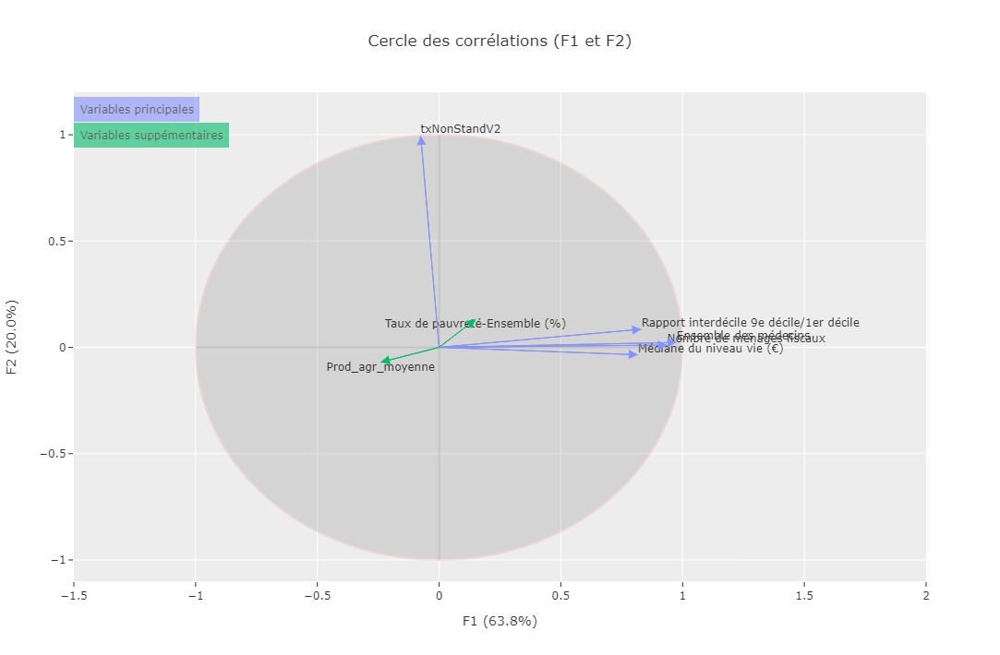

In [104]:
trace_cercle_individus3(liste_variables_x, df_concat, liste_variables_supp, True, True)

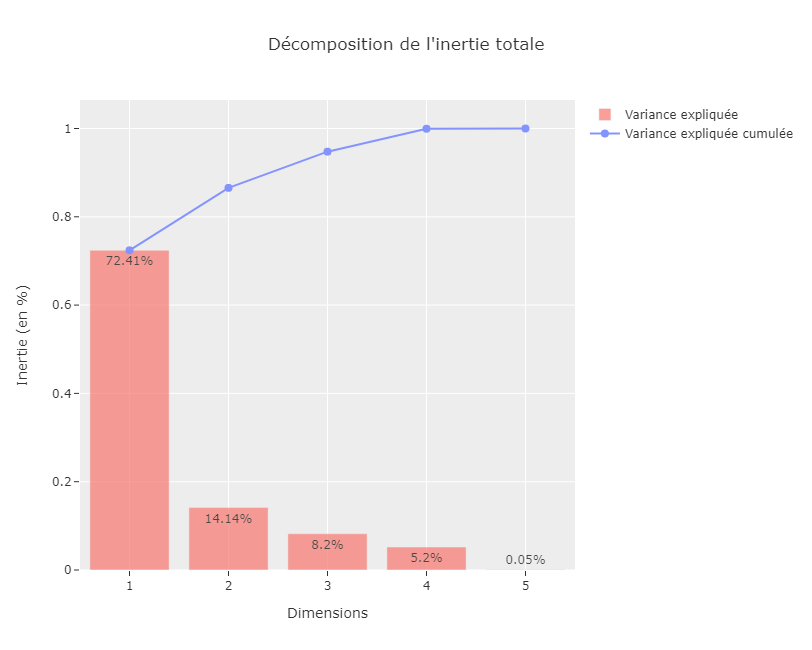

In [48]:
trace_part_var_expliquee_pca2(df_merged_par_region, liste_variables_x, 5)

Le premier plan principal (2 axes principaux) représente près de 90% de la part d’inertie expliquée. 

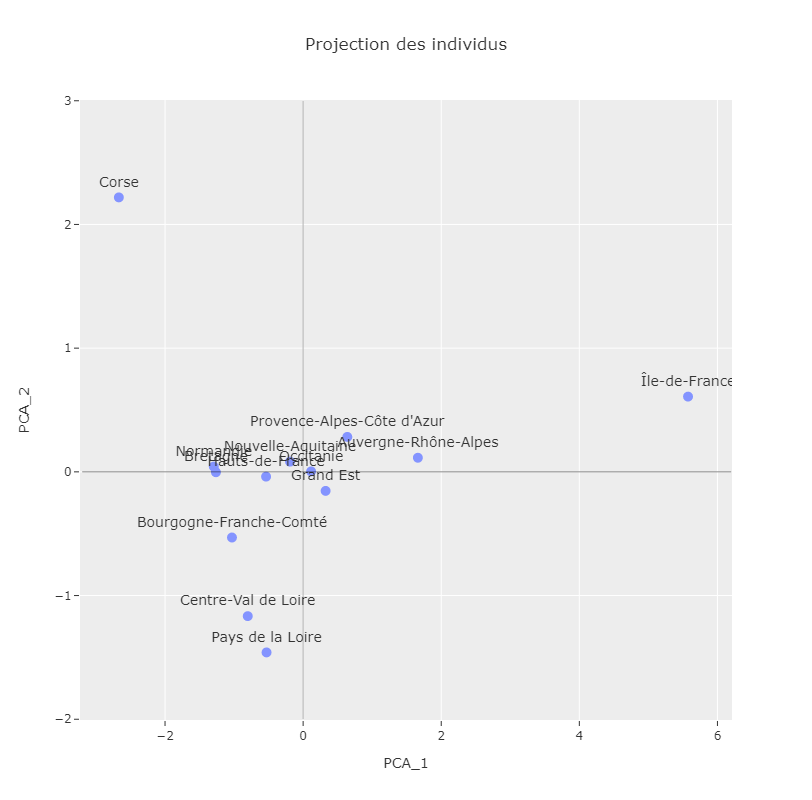

In [49]:
nuage_points_acp2(df_merged_par_region, liste_variables_x, df_merged_par_region['nom'])

## 3.2 : Sélection des variables actives de l'ACP

On va regarder quelles variables ne sont pas corrélées entre elles, pour pouvoir ensuite sélectionner les variables qu'on mettra en actif dans une ACP.

In [109]:
liste_variables_x = ['Ensemble des médecins', 'Ensemble des médecins.1', 'dont général.',
       'dont spécial.', 'Chirurg. dentistes', 'Infirmiers diplômés d’État',
       'Pharm.', 'Part_SAU', 'Prod_agr_moyenne', 'Prod_agr_2018',
       'Part_vegetale', 'Part_animale', 'Grandes cultures',
       'Cultures permanentes', 'Cultures fourragères', 'Autres',
       'Nombre de ménages fiscaux',
       'Nombre de personnes dans les ménages fiscaux',
       'Médiane du niveau vie (€)', 'Part des ménages fiscaux imposés (%)',
       'Taux de pauvreté-Ensemble (%)', 'Taux de pauvreté-moins de 30 ans (%)',
       'Taux de pauvreté-30 à 39 ans  (%)', 'Taux de pauvreté-40 à 49 ans (%)',
       'Taux de pauvreté-50 à 59 ans (%)', 'Taux de pauvreté-60 à 74 ans (%)',
       'Taux de pauvreté-75 ans ou plus (%)',
       'Taux de pauvreté-propriétaires (%)', 'Taux de pauvreté-locataires (%)',
       'Part des revenus d\'activité (%)',
       'dont part des salaires et traitements (%)',
       'dont part des indemnités de chômage (%)',
       'dont part des revenus des activités non salariées (%)',
       'Part des pensions, retraites et rentes (%)',
       'Part des revenus du patrimoine et autres revenus (%)',
       'Part de l\'ensemble des prestations sociales (%)',
       'dont part des prestations familiales (%)',
       'dont part des minima sociaux (%)',
       'dont part des prestations logement (%)', 'Part des impôts (%)',
       '1er décile du niveau de vie (€)', '9e décile du niveau de vie (€)',
       'Rapport interdécile 9e décile/1er décile',
       'txNonStandV2',
       'txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Insuffisance rénale chronique terminale',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies inflammatoires ou rares ou VIH ou SIDA',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Cancers', 'txNonStandV2_Traitements psychotropes',
       'txNonStandV2_Maladies du foie ou du pancréas', 'txNonStandV2_Diabète',
       'txNonStandV2_Traitements du risque vasculaire',
       'txNonStandV2_Maladies neurologiques ou dégénératives','pop_region_2020', 'Variation_totale',
       'Variation_solde_nat', 'Variation_E_S', 'Densite_moyenne']

On va maintenant regarder si certaines distributions sont trop polarisées/trop loin d'une variable gaussienne, pour ne pas les mettre en variables actives ensuite.

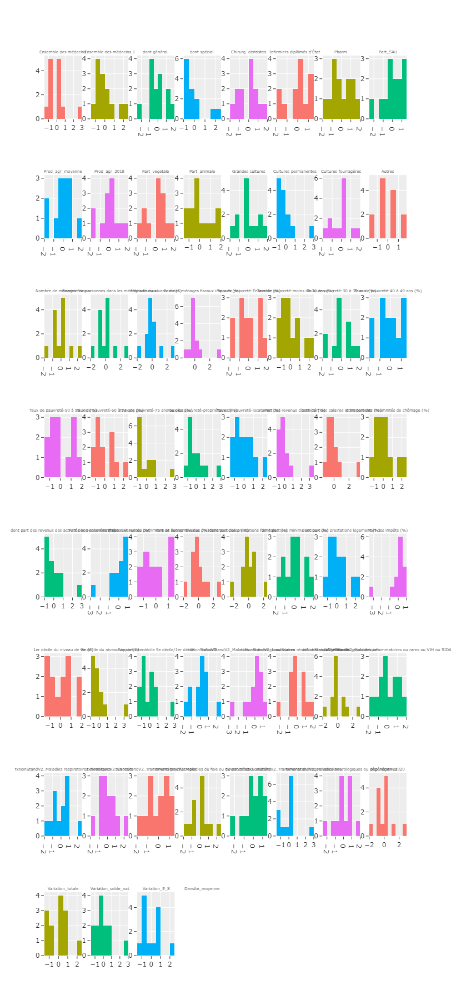

In [53]:
fig = make_subplots(rows=8, cols=8,subplot_titles=df_concat_standard.columns.tolist())

list_j = [1,2,3,4,5,6,7,8,1,2,3,4,5,6,7,8,1,2,3,4,5,6,7,8,1,2,3,4,5,6,7,8,1,2,3,4,5,6,7,8,1,2,3,4,5,6,7,8,1,2,3,4,5,6,7,8,1,2,3,4,5,6,7,8]
list_i = [1,1,1,1,1,1,1,1,
          2,2,2,2,2,2,2,2,
          3,3,3,3,3,3,3,3,
          4,4,4,4,4,4,4,4,
          5,5,5,5,5,5,5,5,
          6,6,6,6,6,6,6,6,
          7,7,7,7,7,7,7,7,
          8,8,8,8,8,8,8,8]
          
for i,j,k in zip(list_i, list_j, range(0,df_concat_standard.shape[1]-1)):
    trace = go.Histogram(x=df_concat_standard[df_concat_standard.columns.tolist()[k]],nbinsx=12)
    fig.append_trace(trace, i, j)
fig.update_layout(showlegend=False,
                  autosize=True,
                  height=1800,
                  width=1100,
                  )
fig.update_annotations(font_size=7)


fig.show()


On voit que la distribution du taux non standardisé du traitement de risque cardio est très polarisé. On le laissera donc en supplémentaire.

In [110]:
liste_variables_x = ['Prod_agr_2018', 'Nombre de ménages fiscaux','Médiane du niveau vie (€)','Ensemble des médecins.1', 'txNonStandV2',
       'txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Insuffisance rénale chronique terminale',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies inflammatoires ou rares ou VIH ou SIDA',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Cancers', 'txNonStandV2_Traitements psychotropes',
       'txNonStandV2_Maladies du foie ou du pancréas', 'txNonStandV2_Diabète',
       'txNonStandV2_Traitements du risque vasculaire',
       'txNonStandV2_Maladies neurologiques ou dégénératives']
df_concat_standard.corr()[liste_variables_x].loc[liste_variables_x].style.background_gradient(cmap='coolwarm')

,Prod_agr_2018,Nombre de ménages fiscaux,Médiane du niveau vie (€),Ensemble des médecins.1,txNonStandV2,txNonStandV2_Maladies cardioneurovasculaires,txNonStandV2_Insuffisance rénale chronique terminale,txNonStandV2_Maladies psychiatriques,txNonStandV2_Maladies inflammatoires ou rares ou VIH ou SIDA,txNonStandV2_Maladies respiratoires chroniques,txNonStandV2_Cancers,txNonStandV2_Traitements psychotropes,txNonStandV2_Maladies du foie ou du pancréas,txNonStandV2_Diabète,txNonStandV2_Traitements du risque vasculaire,txNonStandV2_Maladies neurologiques ou dégénératives
Prod_agr_2018,1.000000,0.027679,-0.231342,-0.209114,-0.027813,0.435217,-0.272238,-0.004521,-0.098013,-0.144133,-0.114813,-0.063410,0.232642,-0.289305,-0.404261,0.059314
Nombre de ménages fiscaux,0.027679,1.000000,0.662416,0.682760,-0.644865,-0.667296,-0.195392,-0.641417,-0.408285,-0.336704,-0.695067,-0.533616,0.430632,-0.051081,-0.555741,-0.633469
Médiane du niveau vie (€),-0.231342,0.662416,1.000000,0.442181,-0.742763,-0.669058,-0.295375,-0.542658,-0.268971,-0.661077,-0.545824,-0.784088,0.000767,-0.333662,-0.537374,-0.701502
Ensemble des médecins.1,-0.209114,0.682760,0.442181,1.000000,-0.189424,-0.387869,0.298583,-0.261045,0.078836,0.068381,-0.048868,-0.071523,0.268836,-0.043701,-0.202077,-0.112246
txNonStandV2,-0.027813,-0.644865,-0.742763,-0.189424,1.000000,0.832137,0.499054,0.812293,0.711290,0.897496,0.816516,0.931604,0.116106,0.429008,0.847914,0.882930
txNonStandV2_Maladies cardioneurovasculaires,0.435217,-0.667296,-0.669058,-0.387869,0.832137,1.000000,0.262091,0.700334,0.661744,0.592549,0.675107,0.691936,0.138339,0.186698,0.533865,0.776148
txNonStandV2_Insuffisance rénale chronique terminale,-0.272238,-0.195392,-0.295375,0.298583,0.499054,0.262091,1.000000,0.225063,0.228227,0.576793,0.606023,0.438439,-0.076481,0.325472,0.575954,0.608522
txNonStandV2_Maladies psychiatriques,-0.004521,-0.641417,-0.542658,-0.261045,0.812293,0.700334,0.225063,1.000000,0.605822,0.692843,0.785306,0.680111,-0.146459,-0.076023,0.603418,0.767149
txNonStandV2_Maladies inflammatoires ou rares ou VIH ou SIDA,-0.098013,-0.408285,-0.268971,0.078836,0.711290,0.661744,0.228227,0.605822,1.000000,0.604801,0.597214,0.613233,0.221729,0.196168,0.558276,0.508365
txNonStandV2_Maladies respiratoires chroniques,-0.144133,-0.336704,-0.661077,0.068381,0.897496,0.592549,0.576793,0.692843,0.604801,1.000000,0.665007,0.861584,0.261595,0.493865,0.836440,0.731025


Le taux non standardisé "global" _txNonStandV2_ est très corrélé aux autres taux, mais les taux ne sont pas très corrélés entre eux. Donc on l'enlève.

## 3.3 On continue notre sélection par tests sucessifs

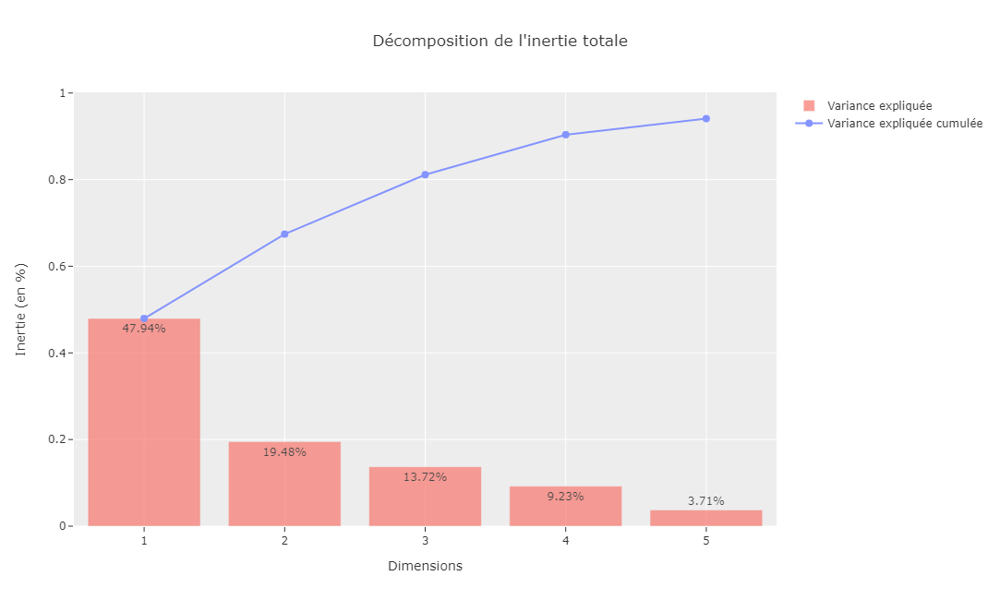

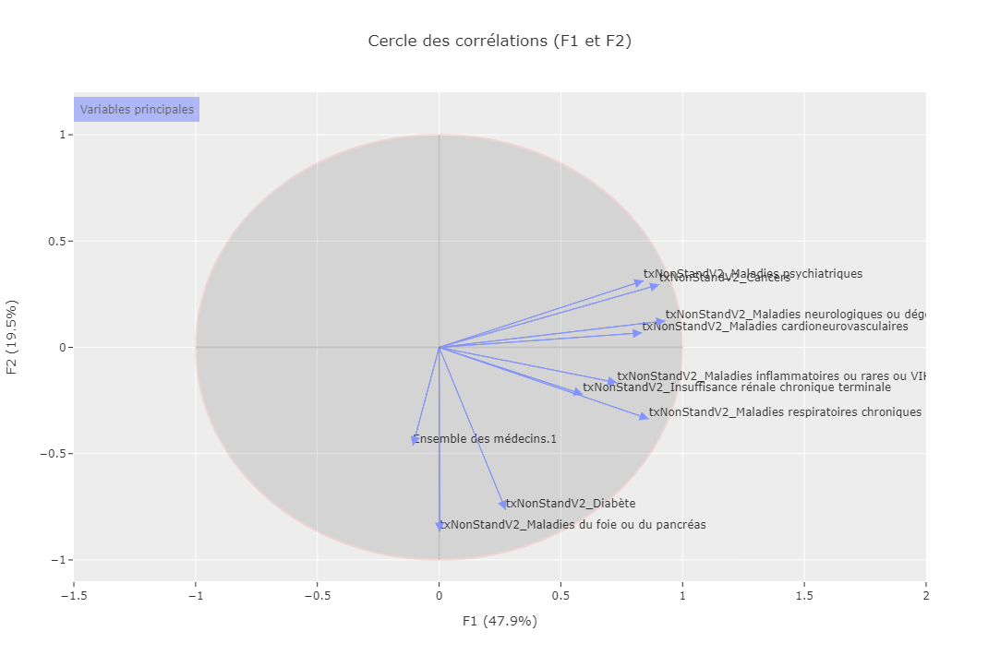

In [179]:
liste_variables_x = ['Ensemble des médecins.1',
       'txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Insuffisance rénale chronique terminale',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies inflammatoires ou rares ou VIH ou SIDA',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Cancers',
       'txNonStandV2_Maladies du foie ou du pancréas', 'txNonStandV2_Diabète',
       'txNonStandV2_Maladies neurologiques ou dégénératives']

liste_variables_supp= []
trace_part_var_expliquee_pca2(df_concat_standard, liste_variables_x, 5)
trace_cercle_individus3(liste_variables_x, df_concat_standard, liste_variables_supp, True)

On va simplifier le graphique. On ne garde que des maladies "pertinentes" : 

- Maladies psychatriques : maladie _a priori_ assez polarisée ;
- Maladies cardioneurovasculaires : spécifique d'un certain âge ;
- Maladies respiratoires : liées à la pollution ou à la cigarette ;
- Diabète et maladies du foie.

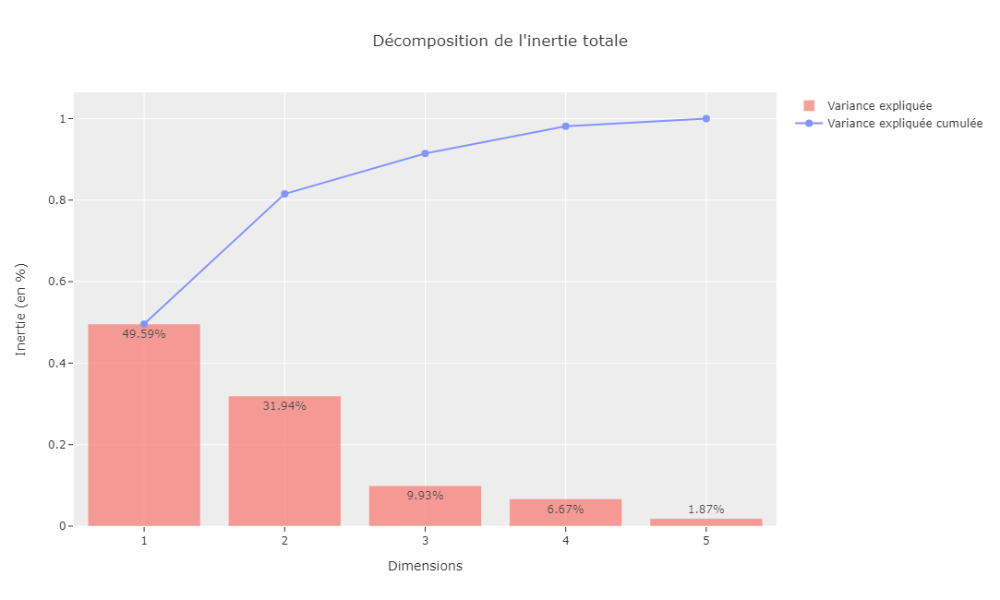

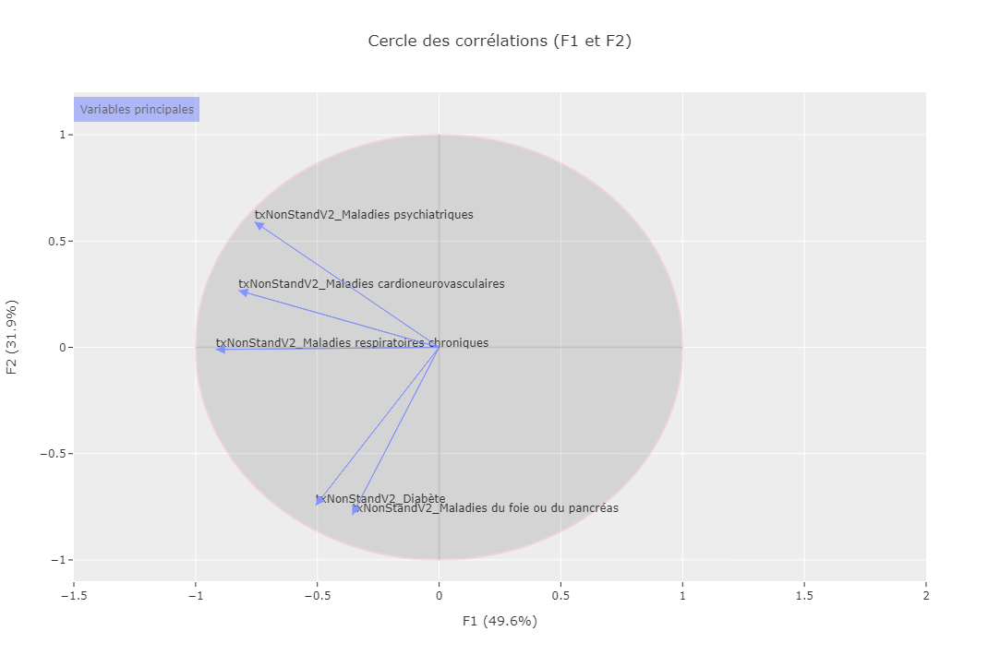

In [112]:
liste_variables_x = ['txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Maladies du foie ou du pancréas',
       'txNonStandV2_Diabète']
liste_variables_supp= []
trace_part_var_expliquee_pca2(df_concat_standard, liste_variables_x, 5)
trace_cercle_individus3(liste_variables_x, df_concat_standard, liste_variables_supp, False)

Concernant la décomposition de l'inertie, utiliser deux axes permet d'expliquer $82\%$ de la variance totale, ce qui justifie le fait de se concentrer uniquement sur deux axes (autrement dit, sur un seul graphique).

## 3.4 : On peut maintenant ajouter des variables supplémentaires sur notre cercle des corrélations

### 3.4.1 : Les variables environnementales

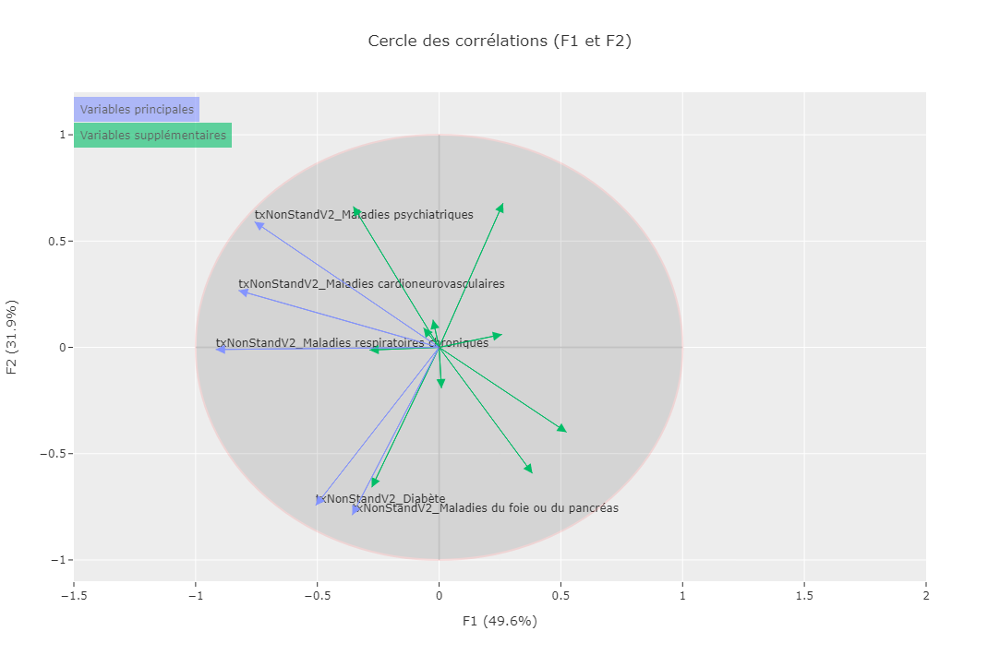

In [187]:
liste_variables_x = ['txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Maladies du foie ou du pancréas',
       'txNonStandV2_Diabète']
liste_variables_supp= ['Part_SAU', 'Prod_agr_moyenne', 'Prod_agr_2018',
       'Part_vegetale', 'Part_animale', 'Grandes cultures',
       'Cultures permanentes', 'Cultures fourragères', 'Autres', "Densite_moyenne"]
trace_cercle_individus3(liste_variables_x, df_concat_standard, liste_variables_supp, True, False)

Remarque : Passer la souris sur les flèches vertes pour avoir le nom des variables supplémentaires.

#### On nettoie un peu, pour rendre le cercle plus facile à analyser

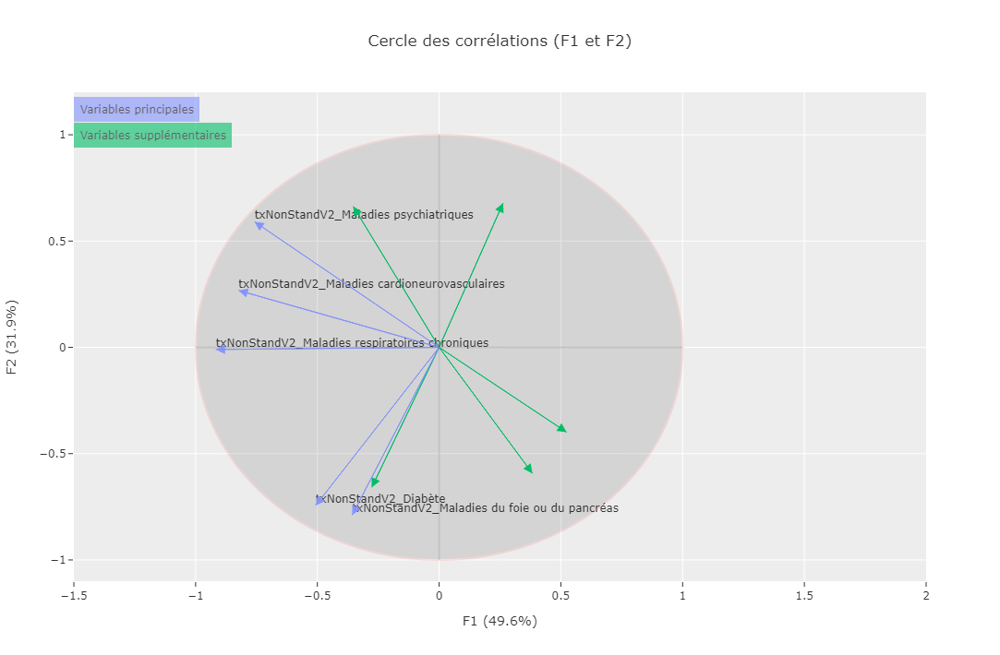

In [188]:
liste_variables_x = ['txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Maladies du foie ou du pancréas',
       'txNonStandV2_Diabète']
liste_variables_supp= ['Part_vegetale', 'Part_animale', 'Grandes cultures', 'Cultures fourragères', 'Densite_moyenne']
trace_cercle_individus3(liste_variables_x, df_concat_standard, liste_variables_supp, True, False)

### 3.4.2 : Les variables socio-économiques

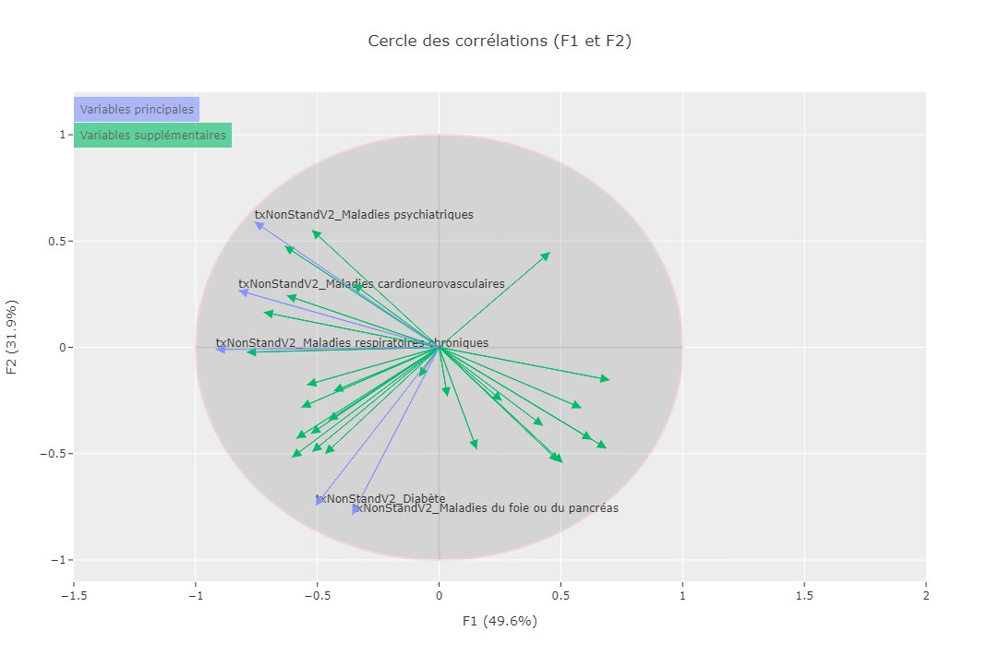

In [189]:
liste_variables_x = ['txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Maladies du foie ou du pancréas',
       'txNonStandV2_Diabète']
liste_variables_supp = [
       'Nombre de ménages fiscaux',
       'Nombre de personnes dans les ménages fiscaux',
       'Médiane du niveau vie (€)', 'Part des ménages fiscaux imposés (%)',
       'Taux de pauvreté-Ensemble (%)', 'Taux de pauvreté-moins de 30 ans (%)',
       'Taux de pauvreté-30 à 39 ans  (%)', 'Taux de pauvreté-40 à 49 ans (%)',
       'Taux de pauvreté-50 à 59 ans (%)', 'Taux de pauvreté-60 à 74 ans (%)',
       'Taux de pauvreté-75 ans ou plus (%)',
       'Taux de pauvreté-propriétaires (%)', 'Taux de pauvreté-locataires (%)',
       'Part des revenus d\'activité (%)',
       'dont part des salaires et traitements (%)',
       'dont part des indemnités de chômage (%)',
       'dont part des revenus des activités non salariées (%)',
       'Part des pensions, retraites et rentes (%)',
       'Part des revenus du patrimoine et autres revenus (%)',
       'Part de l\'ensemble des prestations sociales (%)',
       'dont part des prestations familiales (%)',
       'dont part des minima sociaux (%)',
       'dont part des prestations logement (%)', 'Part des impôts (%)',
       '1er décile du niveau de vie (€)', '9e décile du niveau de vie (€)',
       'Rapport interdécile 9e décile/1er décile']

trace_cercle_individus3(liste_variables_x, df_concat_standard, liste_variables_supp, True, False)

### On re-nettoie

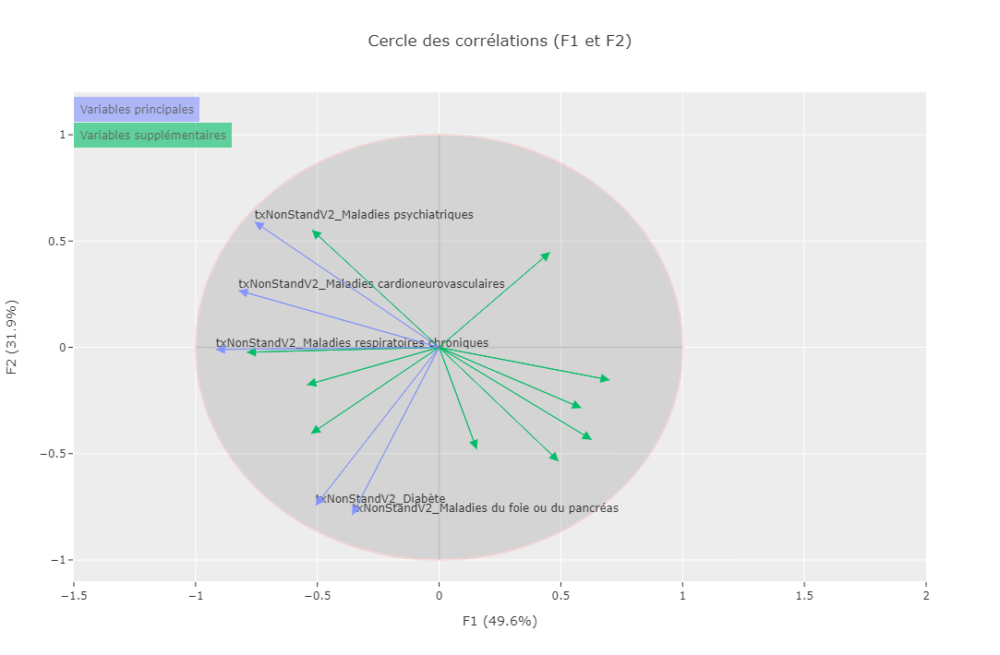

In [191]:
liste_variables_x = ['txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Maladies du foie ou du pancréas',
       'txNonStandV2_Diabète']
liste_variables_supp = ['Taux de pauvreté-Ensemble (%)',
    'Nombre de ménages fiscaux',
    'Médiane du niveau vie (€)', 
    'Part des ménages fiscaux imposés (%)',
    'Part des pensions, retraites et rentes (%)',
    'Part des revenus d\'activité (%)',
    'Part de l\'ensemble des prestations sociales (%)',
    '1er décile du niveau de vie (€)',
    'Rapport interdécile 9e décile/1er décile','dont part des minima sociaux (%)']
trace_cercle_individus3(liste_variables_x, df_concat_standard, liste_variables_supp, True, False)

### 3.4.3 : Les variables liées à l'offre de soins dans la région

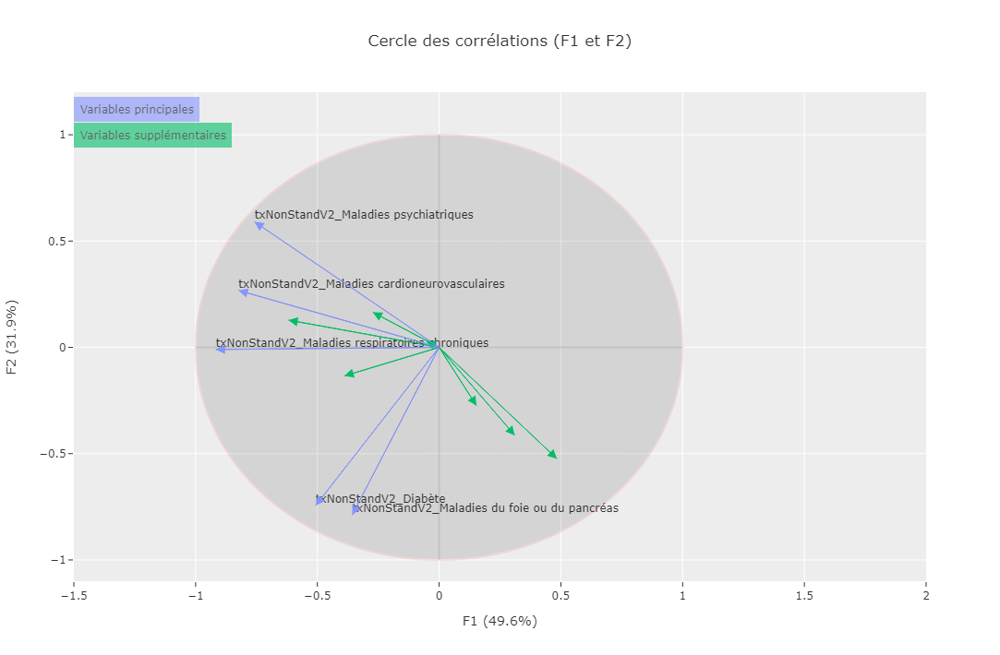

In [192]:
liste_variables_x = ['txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Maladies du foie ou du pancréas',
       'txNonStandV2_Diabète']
liste_variables_supp = ['Ensemble des médecins', 'Ensemble des médecins.1', 'dont général.',
       'dont spécial.', 'Chirurg. dentistes', 'Infirmiers diplômés d’État',
       'Pharm.']
trace_cercle_individus3(liste_variables_x, df_concat_standard, liste_variables_supp, True, False)

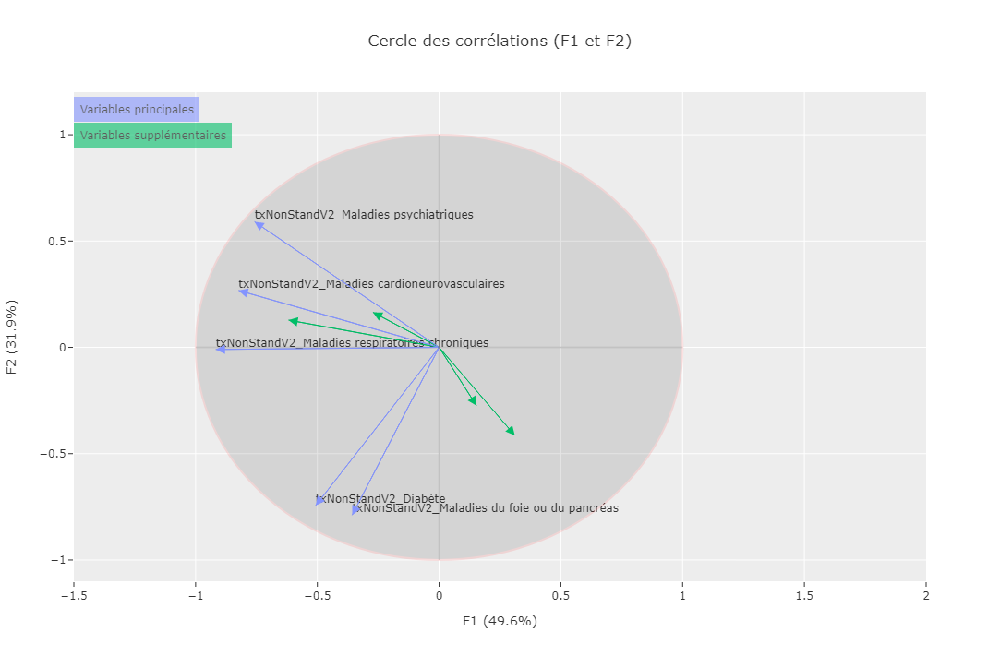

In [193]:
liste_variables_x = ['txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Maladies du foie ou du pancréas',
       'txNonStandV2_Diabète']
liste_variables_supp = ['Ensemble des médecins.1', 'dont général.','dont spécial.', 'Infirmiers diplômés d’État']
trace_cercle_individus3(liste_variables_x, df_concat_standard, liste_variables_supp, True, False)

## 3.5 : Bilan

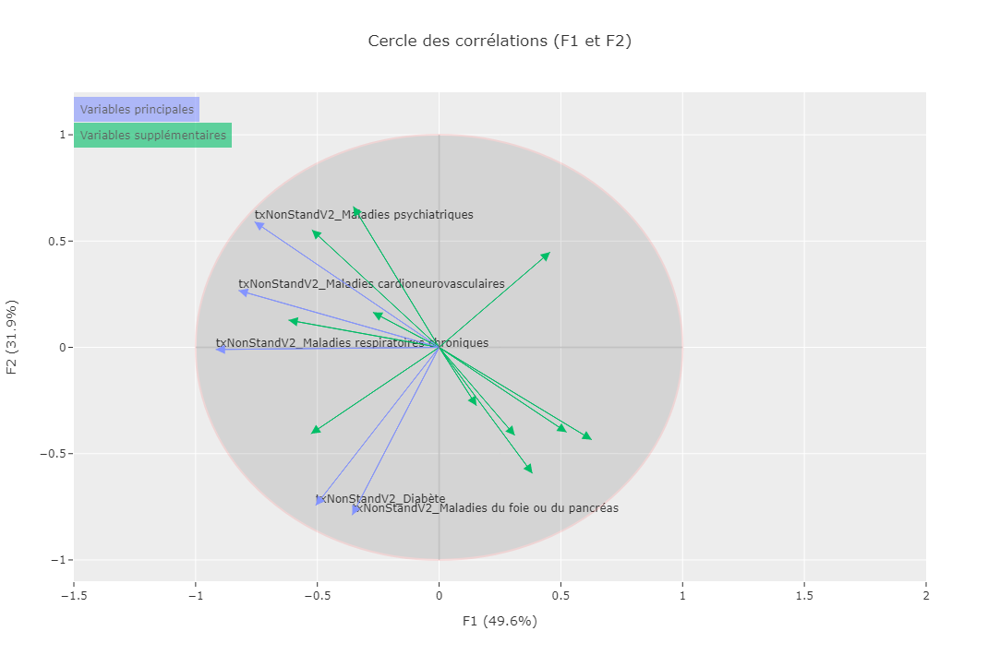

In [194]:
liste_variables_x = ['txNonStandV2_Maladies cardioneurovasculaires',
       'txNonStandV2_Maladies psychiatriques',
       'txNonStandV2_Maladies respiratoires chroniques',
       'txNonStandV2_Maladies du foie ou du pancréas',
       'txNonStandV2_Diabète']
liste_variables_supp = ['Taux de pauvreté-Ensemble (%)','Part des pensions, retraites et rentes (%)','Part des revenus d\'activité (%)',
                        '1er décile du niveau de vie (€)','Ensemble des médecins.1', 'dont général.','dont spécial.',
                        'Infirmiers diplômés d’État', 'Grandes cultures', 'Cultures fourragères', 'Densite_moyenne']
trace_cercle_individus3(liste_variables_x, df_concat_standard, liste_variables_supp, True,False)

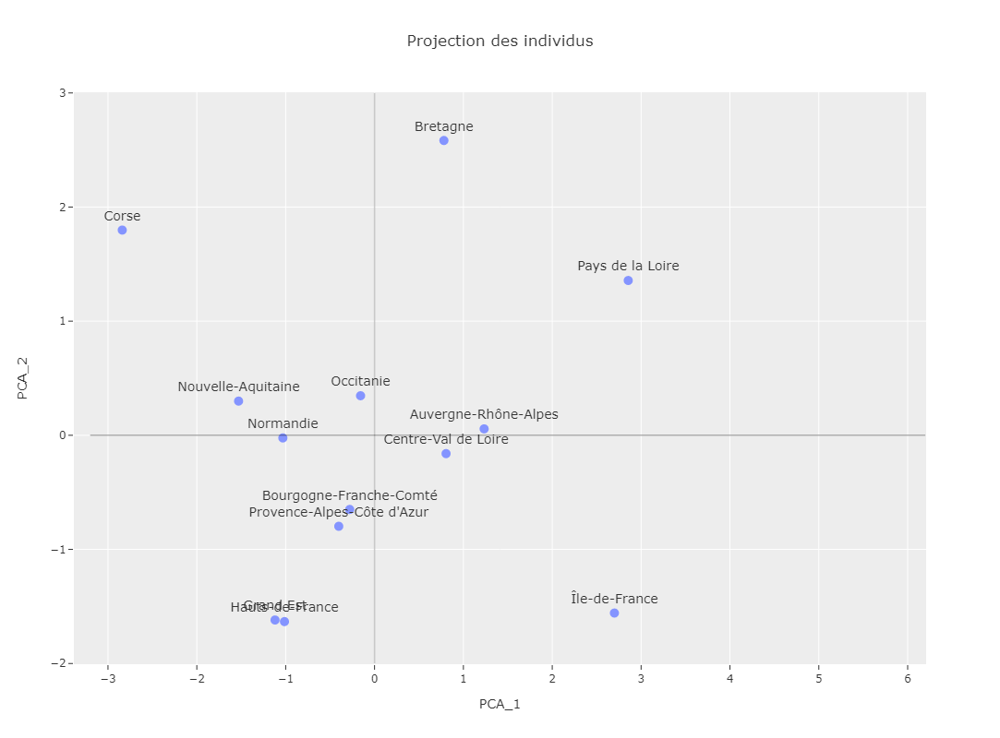

In [195]:
nuage_points_acp2(df_concat_standard, liste_variables_x, df_concat_standard.index)

On peut maintenant projeter les individus, et conclure !

# Partie bonus : La conclusion 

# Interprétation ACP

## Interprétation des axes
- L'axe 1 est déterminé par le taux de diabète et de maladies du foie ou du pancréas. Ce sont deux maladies qui sont liées à des modes de vie spécifiques (respectivement surconsommation d'aliments gras ou sucrés, et alcool) qui font que les individus de classe populaire sont plus touchés par ces affections (Allain 2022, Santé publique France 2022, cf graphiques). 
- L'axe 2 est déterminé par le taux non standardisé de maladies respiratoires chroniques. On suppose ici qu'elles sont liées à un environnement pollué, comme le suggèrent certaines publications médicales (Hernandez 2011).

L'axe 1 mettrait donc en avant les facteurs sociaux et l'axe 2 environnementaux.

Cependant, l'étude de la position des variables supplémentaires met en avant d'autres axes d'analyse diagonaux. La diagonale allant du haut du cercle à gauche au bas à droite relève plutôt d'une opposition rural/urbain, avec plus d'actifs et de professionnels de santé, en particulier spécialisés, ce qui est cohérent avec la littérature existante sur le sujet (DREES 2021). L'autre diagonale relève plutôt de la pauvreté. 

N.B. : La variable premier décile indique ici le revenu seuil à partir duquel, dans chaque région, une personne fait partie du premier décile. Donc plus sa valeur est grande, moins il y a de persnnes en situation de pauvreté (d'où l'opposition avec la flèche taux de pauvreté). 

## Analyse par cadrans
En analysant conjointement le graphique des variables et des individus on peut ensuite interpréter les différents cadrans de l'ACP.

1. **Cadran en haut à gauche :** des territoires peu denses avec des expositions environnementales nocives importantes :
    - exemples de régions : Corse, Nouvelle-Aquitaine
    - Dans ces territoires on remarque des prévalences importantes de maladies psychiatriques, cardioneurovasculaire et respiratoires. Ces maladies peuvent être liées à des expositions nocives, notamment les pesticides pour les maladies chroniques respiratoire type asthme. On sait que par exemple, la Nouvelle-Aquitaine est notamment spécialisée dans la viticulture, culture qui utilise particulièrement beaucoup de pesticides.


2. **Cadran en haut à droite :** des territoires avec un faible taux de pauvreté et peu d'expositions environnementales nocives :
    - exemples de régions : Pays de la Loire, Auvergne-Rhône-Alpes
    - Dans ces territoires, la prévalence des maladies liée au mode de vie (diabète, maladies du foie ou du pancréas) est faible. 


3. **Cadran en bas à gauche :** Des territoires avec un taux de pauvreté important et des expositions environnementales nocives :
    - exemples de régions : Grand-Est, Hauts-de-France, PACA
    - Dans ces territoires, la prévalence et des maladies liées aux facteurs environnementaux et des maladies liées au mode de vie sont élevées.


4. **Cadran en bas à droite :** Des territoires urbains avec des prévalences de maladies chroniques faibles:
    - exemple de région : Ile-de-France
    - Dans ces territoires, la prévalence et des maladies liées aux facteurs environnementaux et des maladies liées au mode de vie sont faibles.


On remarque qu'on ne voit pas d'effet de l'accès aux soins. En effet, on aurait pu penser observer un effet diagnostique, puisque les données sont de nature administratives et ne recensent que les malades diagnostiqués et traités. Or ici le groupe 1, avec l'accès aux soins le plus faible, est un groupe de régions avec des prévalences de maladies chroniques plus important que le groupe 4 qui a pourtant l'accès aux soins (généralistes et spécialisés) le plus élevé. L'effet des inégalités sociales prévaut ici : il est certainement sous-estimé du fait du biais impliqué par la source des données. 
